In [11]:
%matplotlib ipympl
import importlib
import lmfit
import os
import shutil
import matplotlib.pyplot as plt
import numpy as np
import numpy.ma as ma
from astropy.io import fits
from pybaselines import Baseline, utils
from astropy import constants as const
from astropy.table import Table
from astropy.io import fits
from astropy.coordinates import SkyCoord
from pprint import pprint
from gustoL09P.GL09PUtils import *
from gustoL09P.GL09PDataIO import *
from scipy.optimize import minimize

debug = True

showlisting = False

# flag for extended data availability
dataflag = False 

# load L0.8 data
dfile = '/rdat/Projects/GUSTO/Data/level0.8/CII_03519_10084.fits'
dfile = '/rdat/Projects/GUSTO/Data/level0.8/CII_3100-3599/CII_03519_10084.fits'   # no lines
dfile = '/rdat/Projects/GUSTO/Data/level0.8/CII_07903_19643.fits'     # shows CII line in mx 5
dfile = '/rdat/Projects/GUSTO/Data/level0.8/CII_07904_19645.fits'
dfile = '/rdat/Projects/GUSTO/Data/level0.8/CII_07905_19647.fits'
dfile = '/rdat/Projects/GUSTO/Data/level0.8/NII_06488_16648.fits'     # NII line
# dfile = '/rdat/Projects/GUSTO/Data/level0.8/NII_06489_16650.fits'
# dfile = '/rdat/Projects/GUSTO/Data/level0.8/NII_06490_16652.fits'     # weak NII line


plpath = '/rdat/Projects/GUSTO/Data/level0.9_plots'
opath = '/rdat/Projects/GUSTO/Data/level0.8_test'
os.makedirs(plpath, exist_ok=True)
os.makedirs(opath, exist_ok=True)


# line, inDir, outDir, dfile, drmethod, debug = params[0], params[1], params[2], params[3], params[4], params[5]
inDir, froot = os.path.split(dfile)
line = froot.split('_')[0]   #'CII'
outDir = opath

# data reduction method
drmethod = 3

debug = True

pmfileB1 = importlib.resources.files('gustoL09P') / 'Data/ACS5_B1_pixel_masks.txt'
pmfileB2 = importlib.resources.files('gustoL09P') / 'Data/ACS3_B2_pixel_masks.txt'
if line=='NII':
    filter = 'NII*.fits'
    mranges = readMaskRanges(pmfileB1)
    # good pixel ranges
    pxrange = [30,370]
    # ringing check ranges
    pvrange = [200,300]
    pfrange = [30,200]
else:
    filter = 'CII*.fits'
    mranges = readMaskRanges(pmfileB2)
    # good pixel ranges
    pxrange = [90,700]
    # ringing check ranges
    pvrange = [500,590]
    pfrange = [90,400]


verbose = True
vcut = 6.0   # for both, CII and NII
addpixelflag = True   # ['addpixelflag']
checkringflag = True   # params['checkringflag']

# see notebook "bitflag_explore.ipynb"
# istring = "RowFlags.MIXER_MISPUMPED | RowFlags.UNSTABLE_POINTING | RowFlags.MISSING_INT | RowFlags.PROCESSOR_ERROR | RowFlags.DAC_CAL_FIXED"
rowflagfilter = 33555120
# istring = "RowFlags.MIXER_UNPUMPED | RowFlags.MIXER_MISPUMPED | RowFlags.UNSTABLE_POINTING | RowFlags.MISSING_INT | RowFlags.PROCESSOR_ERROR | RowFlags.DAC_CAL_FIXED"
rowflagfilter = 33555184

applychannelfilter = True  # params['applychannelfilter']

if debug:
    fadd = '_m%i'%(drmethod)

# define some additional processing data (maybe relocat to function later?)
if 'CII' in dfile:
    # line: CII
    # all pixels before and after these values are masked as bad
    band = 2
    add = 'B2'
    Tsky = 45  # Kelvin
    rfreq = 1900.5369  # GHz
else:
    # line: NII
    # all pixels before and after these values are masked as bad
    band = 1
    add = 'B1'
    Tsky = 33.5  # Kelvin
    rfreq = 1461.131406

datavalid = True

#logger.info('loading: ', os.path.join(inDir,dfile), ' for line: ', line)
print('Loading file: ', dfile)
spec, data, hdr, hdr1 = loadL08Data(os.path.join(inDir,dfile), verbose=False)
spec_org = spec.copy()
# we perform a global setting of the data mask to avoid math problems
# like division by zero below for Tsys and the calibration
# this defines the global good pixel (or channel) range of the spectra
# and is indicated by setting bit 8 of the channel_flag
# the values in these pixels will be set to nan outside the good range and 
# interpolated within the good range later in the pipeline processing after 
# the baseline fit.
# The channel_flag cannot be set in the mask array, but must be set directly:
# spec.mask[:,pxrange[1]:] = np.bitwise_or(spec.mask[:,pxrange[1]:] ,(1<<7))
# spec.mask[:,:pxrange[0]+1] = np.bitwise_or(spec.mask[:,:pxrange[0]+1], (1<<7))

print()
print('data: ', data.dtype)
print()

# compute velocity
npix    = hdr['NPIX']
IF_pix  = hdr['CRPIX1']
IF_val  = hdr['CRVAL1']
IF_del  = hdr['CDELT1']
IF_freq = (np.arange(npix)-IF_pix)*IF_del+IF_val
VLSRs    = hdr['VLSR'] 
print('\ncmd vlsr: %.1f\n'%(VLSRs))

IF_vlsr0= hdr['IF0']
line_freq = hdr['LINEFREQ']
vlsr    = (IF_vlsr0 - IF_freq)/line_freq*const.c.value/1.e3 + VLSRs # Vlsr in km/s
print('vlsr min/max: ', vlsr.min(), vlsr.max())
print('delta vlsr: ', np.abs(np.diff(vlsr).mean()))
print('vlsr[0]: ', vlsr[0])

ra = data['RA']
dec = data['DEC']
cc = SkyCoord(ra*u.deg, dec*u.deg, frame='icrs')
gl = cc.galactic.l.deg
gb = cc.galactic.b.deg

#check if Thot is in hdr
if not 'THOT' in hdr:
    print('GL09Pipeline: THOT keyword not in FITS-header')
 
data['CHANNEL_FLAG'][:,pxrange[1]:] = np.bitwise_or(data['CHANNEL_FLAG'][:,pxrange[1]:] ,(1<<7))
data['CHANNEL_FLAG'][:,:pxrange[0]+1] = np.bitwise_or(data['CHANNEL_FLAG'][:,:pxrange[0]+1], (1<<7))
if applychannelfilter:
    if debug:
        fadd += '_ac'
    spec.mask = data['CHANNEL_FLAG']
    if addpixelflag:
        # more agressive spur flagging
        for i in range(mranges.shape[0]):
            # set the spur flag for the mranges
            data['CHANNEL_FLAG'][:,mranges[i,0]:mranges[i,1]+1] = np.bitwise_or(data['CHANNEL_FLAG'][:,mranges[i,0]:mranges[i,1]+1] ,(1<<7))
            spec.mask = data['CHANNEL_FLAG']
else:
    spec.mask = np.zeros(spec.shape)

n_spec, n_pix = spec.shape

rfs = checkRowflag(data['ROW_FLAG'], rowflagfilter=rowflagfilter)


if showlisting:
    print(' idx mx   rowflag rfs inttime   type       RA           Dec       unixtime      <spec> scanID')
    for i in range(n_spec):
        print('%4i %2i %9i %2i  %7.5f %7s %11.5f, %11.5f, %12.3f %7.3f %5i'%(i, data['MIXER'][i], data['ROW_FLAG'][i], rfs[i], data['INTTIME'][i], 
                    data['scan_type'][i], data['ra'][i], data['DEC'][i], data['UNIXTIME'][i], np.ma.mean(spec[i,200:400]), data['scanID'][i]))


Loading file:  /rdat/Projects/GUSTO/Data/level0.8/NII_06488_16648.fits

data:  (numpy.record, [('MIXER', '>i4'), ('NINT', '>i4'), ('UNIXTIME', '>f8'), ('NBYTES', '>i4'), ('CORRTIME', '>i4'), ('INTTIME', '>f4'), ('ROW_FLAG', '>i4'), ('Ihigh', '>i4'), ('Qhigh', '>i4'), ('Ilow', '>i4'), ('Qlow', '>i4'), ('Ierr', '>i4'), ('Qerr', '>i4'), ('VIhi', '>f4'), ('VQhi', '>f4'), ('VIlo', '>f4'), ('VQlo', '>f4'), ('scanID', '>i4'), ('subScan', '>i4'), ('scan_type', 'S6'), ('RA', '>f4'), ('DEC', '>f4'), ('filename', 'S48'), ('PSat', '>f4'), ('Vmon', '>f4'), ('Imon', '>f4'), ('Gmon', '>f4'), ('DATA', '>f4', (512,)), ('CHANNEL_FLAG', '>i2', (512,))])


cmd vlsr: 0.0

vlsr min/max:  -800.1950448008804 225.6960382771714
delta vlsr:  2.0076146439883598
vlsr[0]:  225.6960382771714


In [2]:
# for now, process all mixers
umixers = np.unique(data['MIXER'])
n_umix = umixers.size
#data = data1

print('file: ', froot)
print('Method: ', drmethod)
print('N spectra: ', n_spec)
#print()

def huber_loss(z):
    out = z * 1.0
    out[np.where(z > 1)] = 2*np.sqrt(z) - 1
    return out

tsyseff_avg = np.zeros(umixers.size)
aTsyseff = np.zeros([n_spec,n_pix])
aTsys_mean = np.zeros([n_umix])
amixer = np.zeros(n_umix)
ahcorr = np.zeros([n_spec,n_pix])
ascorr = np.zeros([n_spec,n_pix])
aspref = np.zeros([n_spec,n_pix])
aspref2 = np.zeros([n_spec,n_pix])
ahcoef = np.zeros([n_spec,30])
afrac = np.zeros([n_spec,2])
aTam = np.zeros([n_spec])
aTrms = np.zeros([n_spec])
asscl = np.zeros([n_spec])
aTa = np.zeros([n_spec,n_pix])
aTa2 = np.zeros([n_spec,n_pix])
anit = np.zeros([n_spec], dtype=int)
asucc = np.zeros([n_spec], dtype=bool)
if drmethod==3:
    aTsyseff_sm = np.zeros([n_spec,n_pix])
    ahcorr_sm = np.zeros([n_spec,n_pix])
    aspref_sm = np.zeros([n_spec,n_pix])
    aspref2_sm = np.zeros([n_spec,n_pix])
aghots = []   # hots
aghtim = []   # unixtime of hots
aghtint = []  # integration time of hots
aghmix = []   # mixer of hots
atsys = []
ayfac = []
atsmix = []
datavalid = np.ones(n_umix, dtype=bool)
rfsflag = 0

tic = time.time()

for k, mix in enumerate(umixers):
    # first check crudely if we have enough data of various scan_types
    print('\nProcessing mixer: ', mix)
    msel = np.nonzero(data['MIXER']==mix)
    rflag = checkRowflag(data['ROW_FLAG'], rowflagfilter=rowflagfilter)
    amixer[k] = mix
    
    scanID = data['scanID']
    rfsel = (data['MIXER'] == mix) & (data['scan_type'] == 'REF') & (rflag)
    rfsID = np.unique(scanID[rfsel])
    rhsel = (data['MIXER'] == mix) & (data['scan_type'] == 'REFHOT') & (rflag)
    rhsID = np.unique(scanID[rhsel])
    htsel = (data['MIXER'] == mix) & (data['scan_type'] == 'HOT') & (rflag)
    hotID = np.unique(scanID[htsel])
    otsel = (data['MIXER'] == mix) & (data['scan_type'] == 'OTF') & (rflag)
    otfID = np.unique(scanID[otsel])
    print('rfsID / rhsID / hotID / otfID: ', rfsID, rhsID, hotID, otfID)
    
 
    otfID, rfsID, rhsID, hotID = getSpecScanTypes(mix, spec, data, hdr, rowflagfilter=rowflagfilter)
    print('rfsID / rhsID / hotID / otfID: ', rfsID, rhsID, hotID, otfID, '\n')
    check = (np.argwhere(data['scan_type']=='REF').size > 3) & \
            (np.argwhere(data['scan_type']=='HOT').size > 3) & \
            (np.argwhere(data['scan_type']=='REFHOT').size > 3) & \
            (np.argwhere(data['scan_type']=='OTF').size > 5) & \
            (otfID.size>0) & (rfsID.size>0) & (rhsID.size>0) & (hotID.size>0) & np.any(rflag[msel])
            # (otfID.size>0) & (rfsID.size>0) & (rhsID.size>0) & (hotID.size>0) & np.any(data['ROW_FLAG'][msel]==rowflagfilter)
    if not check:
        print('mix, dfile')
        print('check: ', check)
        print('specs: ', spec.shape)
        print('REFs: ', np.argwhere(data['scan_type']=='REF').size, (np.argwhere(data['scan_type']=='REF').size > 3))
        print('HOTs: ', np.argwhere(data['scan_type']=='HOT').size, (np.argwhere(data['scan_type']=='HOT').size > 3))
        print('REFHOTs: ', np.argwhere(data['scan_type']=='REFHOT').size, (np.argwhere(data['scan_type']=='REFHOT').size > 3))
        print('OTFs: ', np.argwhere(data['scan_type']=='OTF').size, (np.argwhere(data['scan_type']=='OTF').size > 5))
        print('other: ', (otfID.size>0), (rfsID.size>0), (rhsID.size>0), (hotID.size>0))
        print('IDs: ', rfsID, rhsID, hotID, otfID)
        print('rowflagfilter: ', rowflagfilter, np.any(checkRowflag(data['ROW_FLAG'][msel], rowflagfilter=rowflagfilter)))
        print('GL09Pipeline: Not enough data available for processing. ROW_FLAGs are set appropriately. ')
        data['ROW_FLAG'][msel] |= 4   # flagged as missing data
        datavalid[k] = False
        print()
        print()
        continue
    
    tsys, refs, rhots, rtime, htime, Thot, Tsky, rhIDs, rfsflags, yfac = getCalSpectra(mix, spec, data, hdr, rowflagfilter=rowflagfilter, verbose=True)
    rfsflag += rfsflags*10**k
    # tsys is a masked array if valid or an int if no good
    if type(tsys)==type(0):
        print('No Tsys available! Stopped processing of mixer %i of dfile %s'%(mix, dfile), tsys)
        # logger.error('No Tsys available! Stop processing mix of dfile ', mix, dfile, tsys)
        # logger.info('Tsys: ', tsys)
        datavalid[k] = False
        continue
    tsys_mean = np.nanmean(tsys[:,pxrange[0]:pxrange[1]])
    aTsys_mean[k] = tsys_mean
    print('<Tsys_%i>: %.2f'%(mix, tsys_mean))
    tsys.fill_value = 0.0
    #print('tsys shape: ', tsys.shape)
    #print(list(tsys))
    prange = [40, 350]
    #pxs = np.arange(n_pix)
    

    
    # otfID, rfsID, rhsID, hotID = getSpecScanTypes(mix, spec, data, hdr, rowflagfilter=rowflagfilter, verbose=verbose)
    # osel = np.argwhere((otfID == data['scanID']) & (otfID.size>=1) & (rfsID.size>2) & (rhsID.size>2) & (hotID.size>2) & (mix == data['MIXER']) & (data['scan_type'] == 'OTF') & (data['ROW_FLAG']==0))
    # 3/8/25: changed this check to exclude the requirement for HOTs since we have sequences without HOT measurements!
    osel = np.argwhere((otfID == data['scanID']) & (rfsID.size>=1) & (rhsID.size>=1) & #(hotID.size>=1) & 
                       (otfID.size>=1) & (mix == data['MIXER']) & (data['scan_type'] == 'OTF') & 
                       (rflag)).flatten()
    #print('otfID.size: ', otfID.size)
    #print('osel: ', len(osel))
    if len(osel) > 2:
        # print('processing OTFs')
        # print('OTFs: ', otfID)
        # print('REFs: ', rfsID)
        # print('REFHOTs: ', rhsID)
        # print('HOTs: ', hotID)
        # print('mixer: ', mix)
        pass
    else:
        print('WARNING: No OTF spectra available for mixer: ', mix)
        # logger.warning('No OTF spectra available.')
        # print('failed processing OTFs')
        # print('scanID: ', (otfID == data['scanID']), '\nrfsID: ', (rfsID.size>=1), '\nrhsID: ', (rhsID.size>=1), '\notfID: ', (otfID.size>=1), 
        #                '\nmix: ', (mix == data['MIXER']), '\nscan type: ', (data['scan_type'] == 'OTF'), '\nrowflag: ', (data['ROW_FLAG'][mix]==0))
        # print('rowflag: ', (data['ROW_FLAG']))
        # print(osel)
        # print('OTFs: ', otfID)
        # print('REFs: ', rfsID)
        # print('REFHOTs: ', rhsID)
        # print('HOTs: ', hotID)
        # print('rfsflag: ', rfsflag)
        # print('mixer: ', mix)
        #print(k, mix, umixers)
        datavalid[k] = False
        data['ROW_FLAG'][msel] |= 1<<19   # flagged as missing data
        continue

    spec_OTF = np.squeeze(spec[osel,:])
    stime = data['UNIXTIME'][osel]
    btime = (rtime[0] + htime[0]) / 2. # before OTFs
    atime = (rtime[1] + htime[1]) / 2. # after OTFs
    if atime > btime:
        fracb = (stime - btime) / (atime - btime)
        fraca = (atime - stime) / (atime - btime)
    else:
        # this is for the case of a single REF/REFHOT pair
        fraca = np.ones(stime.size) / 2.
        fracb = np.ones(stime.size) / 2.
    
    n_OTF, n_opix = spec_OTF.shape
    # antenna temperature is a masked array
    ta = ma.zeros([n_OTF, n_opix])
    ta.mask = spec.mask
    ta2 = ma.zeros([n_OTF, n_opix])
    ta2.mask = spec.mask
    nit = np.ones(n_OTF, dtype=int)
    succ = np.ones(n_OTF, dtype=bool)
    scl = np.ones([n_OTF, n_opix])
    sscl = np.ones(n_OTF)
    tam = np.zeros(n_OTF)
    trms = np.zeros(n_OTF)
    tsyseff = np.zeros([n_OTF, n_opix])
    hcorr = np.zeros([n_OTF, n_opix])
    scorr = np.zeros([n_OTF, n_opix])
    hcoef = np.zeros([n_OTF, 30])
    spref = np.zeros([n_OTF, n_opix])
    spref2 = np.zeros([n_OTF, n_opix])
    if drmethod==3:
        tsyseff_sm = np.zeros([n_OTF, n_opix])
        hcorr_sm = np.zeros([n_OTF, n_opix])
        spref_sm = np.zeros([n_OTF, n_opix])
        spref2_sm = np.zeros([n_OTF, n_opix])

    # this call returns the results for all spectra, but we need only everything for the OTF spectra
    # ahgroup is the assignment of hots to all spectra
    # aghots are the grouped hots
    # aghtim is the unixtime associated with the grouped hots
    # aglast is a flag indicating that there is a hot at the end of the OTF strip
    ahgroup, ghots, ghtim, ghtint, glast, htflag = getHotInfo(spec, data, mix, dfile=dfile, rowflagfilter=rowflagfilter, verbose=True)
    if type(ahgroup)==type(0):
        print('Encountered problem with HOT groups. Flaging rows.')
        data['ROW_FLAG'][msel] |= 1<<19   # flagged as missing data
        continue
    # reduce the assignment to the OTF spectra only
    hgroup = ahgroup[osel]
    gsz = ghots.shape
    n_ghots = gsz[0]
    if n_ghots > 0:
        aghots.append(ghots)
        aghtim.append(ghtim)
        aghtint.append(ghtint)
        aghmix.append(np.zeros(n_ghots)+mix)
    else:
        print('No hots available...')
        data['ROW_FLAG'][msel] |= 1<<19   # flagged as missing data
        continue
    

    atsys.append(tsys)
    ayfac.append(yfac)
    atsmix.append(mix)
    
    if drmethod==3:
        # Define the model function
        def scalefunc(params, spec, sRn):
            model = params['a0']
            nRs, _ = sRn.shape
            for i in range(1,nRs):
                model += params['a%i'%(i)].value * sRn[i-1,:]
            return ((spec - model)/model)**2
        
        def getsRf(params, sRn):
            model = params['a0']
            nRs, _ = sRn.shape
            for i in range(1,nRs):
                model += params['a%i'%(i)].value * sRn[i-1,:]
            return model
        
        seq_hots = np.vstack([rhots,ghots])
        n_shots = seq_hots.shape[0]
    
    if drmethod==4:
        def scalefunc(x, c1, c2):
            x1=x[0]
            x2=x[1]
            y = c1 - (c2 * x1 +x2)
            # Return square difference 
            return(np.sum(y*y))
        # rhots and refs should be same number of scans, but might not be
        nhot = rhots.shape[0]
        nref = refs.shape[0]
        nghot = ghots.shape[0]

        # we got the y-factor above
        if yfac.shape[0] == 2:
            y1 = yfac[0,:]
            y2 = yfac[1,:]
        else:
            y1 = yfac[0,:]
            y2 = yfac[0,:]

        # combine all HOTs
        seq_hots = np.vstack([rhots,ghots])

    if drmethod==5:
        # Define the model function
        def scalefunc(params, spec, sRn):
            model = params['a0']
            nRs, _ = sRn.shape
            for i in range(1,nRs):
                model += params['a%i'%(i)].value * sRn[i-1,:]
            return ((spec - model)/model)**2
        
        def getsRf(params, sRn):
            model = params['a0']
            nRs, _ = sRn.shape
            for i in range(1,nRs):
                model += params['a%i'%(i)].value * sRn[i-1,:]
            return model
        
        # seq_hots = np.vstack([rhots,ghots])
        # n_shots = seq_hots.shape[0]
    
    # create the calibrated spectra
    for i0 in range(n_OTF):
        tsyseff[i0,:] = fracb[i0] * tsys[0,:] + fraca[i0] * tsys[1,:]
        # we might have to replace flagged pixels in tsyseff to not cause a problem in the spectra
        # => skipped for now since pixel flags should be very similar to flagged pixels in spectra
        if drmethod==1:
            # method 1
            spref[i0,:] = fracb[i0] * refs[0,:] + fraca[i0] * refs[1,:]
            ta[i0,:] = 2.*tsyseff[i0,:] * (spec_OTF[i0,:] - spref[i0,:])/spref[i0,:]
        elif drmethod==2:
            # method 2: using HOTS to mitigate drifts
            # apply the REFHOTS to the refs
            # ToDo: check if the inttime of refs/hots/otfs matters
            # calculate the fraction of hot used for the spectrum
            ht1 = ghtim[hgroup[i0]]
            if hgroup[i0]+1 <= hgroup.max():
                ht2 = ghtim[hgroup[i0]+1]
            else:
                ht2 = ghtim[hgroup[i0]]
            # ht2 = ghtim[hgroup[i0]+1]
            if ht2 > ht1:
                hfrac = (stime[i0]-ht1)/(ht2-ht1)
            else:
                hfrac = 1.0
            # determine the hots for the individual OTF spectra
            if hgroup[i0]+1 <= hgroup.max():
                hcorr[i0,:] = ghots[hgroup[i0],:]*hfrac + (1-hfrac) * ghots[hgroup[i0]+1,:]
            else:
                hcorr[i0,:] = ghots[hgroup[i0],:]*hfrac + (1-hfrac) * ghots[hgroup[i0],:]
            #hcorr_sm[i0,:] = smoothSpectrum(hcorr[i0,:], cflag, window_length=5, polyorder=2)
            # hcorr[i0,:] = ghots[hgroup[i0],:]*hfrac + (1-hfrac) * ghots[hgroup[i0]+1,:]
            # determine the hots-reduced REF spectra
            # spref[i0,:] = (fracb[i0] * refs[0,:] / ghots[0,:] + fraca[i0] * refs[1,:] / ghots[-1,:]) * hcorr[i0,:]
            scorr[i0,:] = hcorr[i0,:] / (fracb[i0] * rhots[0,:] + fraca[i0] * rhots[1,:])
            spref[i0,:] = (fracb[i0] * refs[0,:] + fraca[i0] * refs[1,:]) * scorr[i0,:]
            spref2[i0,:] = fracb[i0] * refs[0,:] + fraca[i0] * refs[1,:]
            #spref_sm[i0,:] = smoothSpectrum(spref_sm[i0,:], cflag, window_length=5, polyorder=2)
            
            # calculate a scaling factor
            scl[i0,:] = spec_OTF[i0,:] / (spref[i0,:])
            sscl[i0] = ma.median(scl[i0,:])
            #print('Scaling factor: %.4f'%(sscl[i0]))
            
            # put everything together. issue: divide by zero -> catch in masks
            ta[i0,:] = 2.*tsyseff[i0,:] * (spec_OTF[i0,:] - spref[i0,:])/spref[i0,:]
            ta2[i0,:] = 2.*tsyseff[i0,:] * (spec_OTF[i0,:] - spref[i0,:])/spref2[i0,:]
            
            ta[i0,:] = ta[i0,:] - ma.median(ta[i0,:])
            ta2[i0,:] = ta2[i0,:] - ma.median(ta2[i0,:])
            
            # calculate an average Ta
            if np.any(np.isfinite(ta[i0,pxrange[0]:pxrange[1]])):
                tam[i0] = np.nanmean(ta[i0,pxrange[0]:pxrange[1]])
            else:
                tam[i0] = np.nan
            # print('Ta mean (%i): %.4f'%(i0, Ta_mean), hgroup[i0], hfrac, fraca[i0], fracb[i0], stime[i0], ht1, ht2)
            
        elif drmethod==3:
            
            sspec = spec_OTF[i0,:]
            
            yvalid = np.nonzero((yfac[1,:].squeeze() > 1.0))[0]
            sRn = seq_hots / yfac[1,:].squeeze()
            
            # Create parameters
            params = lmfit.Parameters()
            vals = np.zeros(n_shots) + 0.5
            vals[0] = 0.0
            for index, value in enumerate(vals):
                params.add('a%i'%index, value=vals[index])
            # Minimize the objective function
            mini = lmfit.Minimizer(scalefunc, params, fcn_args=(sspec[yvalid], sRn[:,yvalid]))
            result = mini.minimize(method='least_squares', max_nfev=1000)

            # mini = lmfit.Minimizer(scalefunc, params, fcn_args=(sspec[yvalid], sRn[:,yvalid]), reduce_fcn= huber_loss)
            # # result = mini.minimize(method='least_squares', max_nfev=1000)
            # result = mini.minimize(method='least_squares')
            
            nit[i0] = result.nfev
            succ[i0] = result.success
            sR = getsRf(result.params, sRn)
            spref[i0,:] = sR 
            hcoef[i0,:n_shots] = np.array(list(result.params.valuesdict().values()))

            ta[i0,:] = 2.*tsyseff[i0,:] * (sspec-sR)/sR
            trms[i0] = np.std(ta[i0,yvalid])

        elif drmethod==4:
            
            cflag = data['CHANNEL_FLAG'][i0,:]
            #  S-R / R implementation fitting R to S
            spec_otf1 = spec_OTF[i0,:]

            # Useable Y factors should be > 1.0
            quse = np.argwhere((y1 > 1.0) & (cflag == 0))
            nsamp = quse.shape[0]
            #print("Good channels",nsamp)
            if nsamp == 0:
                #Try 2nd Y factor y2
                print('switching to 2nd Y')
                y1 = y2
                quse = np.argwhere((y2 > 1.0) & (cflag == 0))
                nsamp = quse.shape[0]

            if nsamp > 0:

                testvar = []
                mincoeffs = []
                synRefs=[]
                for hot1 in seq_hots:
                    sR1 = hot1/y1
                    xstart = [1.,0.0]
                    synRefs.append(sR1)
                    minresult = minimize(scalefunc,xstart,args=(spec_otf1[quse],sR1[quse]))
                    mincoeffs.append(minresult.x)
                    testvar.append(minresult.fun/nsamp)
                    #print(testvar, minresult.x)
                testvar = np.array(testvar)
                mincoeffs = np.array(mincoeffs)
                #find the minimum variance
                qmin = np.argmin(testvar)
                #print(mincoeffs.shape)
                #print(testvar[qmin],mincoeffs[qmin])
                synRef = mincoeffs[qmin][0]*synRefs[qmin] + mincoeffs[qmin][1]
                
                Ta_otf = 2. * tsyseff[i0,:] * ( spec_otf1 - synRef ) / synRef
                # Ta_otf = 2. * Tsys_nominal * ( spec_otf1 - synRef ) / synRef
                ta[i0,:] = Ta_otf
                trms[i0] = np.std(Ta_otf[quse])
                # this line is wrong!
                BW = hdr['CDELT1']*1e6 *2 
                #Expected = np.median(tsyseff1[quse])/np.sqrt(BW*0.33)
                Expected = 1100.0/np.sqrt(BW*0.33)
                #print(Trms / Expected)
        elif drmethod==5:
            
            sspec = spec_OTF[i0,:]
            
            seq_hots = ghots[hgroup[i0],:]
            if hgroup[i0]+1 <= hgroup.max():
                seq_hots = np.vstack([seq_hots, ghots[hgroup[i0]+1,:]])
            if hgroup[i0]-1 >= 1:
                seq_hots = np.vstack([seq_hots, ghots[hgroup[i0]-1,:]])
            n_shots = seq_hots.shape[0]
            
            yvalid = np.nonzero((yfac[1,:].squeeze() > 1.0))[0]
            sRn = seq_hots / yfac[1,:].squeeze()
            try:
                # Create parameters
                params = lmfit.Parameters()
                vals = np.zeros(n_shots) + 0.5
                vals[0] = 0.0
                for index, value in enumerate(vals):
                    params.add('a%i'%index, value=vals[index])
                
                # Minimize the objective function
                mini = lmfit.Minimizer(scalefunc, params, fcn_args=(sspec[yvalid], sRn[:,yvalid]))
                result = mini.minimize()
            except:
                print('Problems with REF fitting for spectrum %i in %s ...'%(i0, dfile), flush=True)
                data['ROW_FLAG'][i0] |= 1<<24   # flagged as failed fit
                continue
                

            sR = getsRf(result.params, sRn)
            spref[i0,:] = sR 
            hcoef[i0,:n_shots] = np.array(list(result.params.valuesdict().values()))

            ta[i0,:] = 2.*tsyseff[i0,:] * (sspec-sR)/sR
            trms[i0] = np.std(ta[i0,yvalid])



    # now we have to save the data in a FITS file
    # Note: changing the output data format to
    # primarily passing through the header and the data table
    # and only few variables and the header keys are updated or added
    
    tsyseff_avg[k] = np.nanmean(tsys[:,int(pxrange[0]):int(pxrange[1])+1])
    aTsyseff[osel,:] = tsyseff
    ahcorr[osel,:] = hcorr
    ascorr[osel,:] = scorr
    aspref[osel,:] = spref
    afrac[osel,0] = fraca
    afrac[osel,1] = fracb
    ahcoef[osel,:] = hcoef
    aTa[osel,:] = ta
    aTam[osel] = tam
    aTrms[osel] = trms
    anit[osel] = nit
    asucc[osel] = succ
    asscl[osel] = sscl
    aspref2[osel,:] = spref2
    aTa2[osel,:] = ta2
    if drmethod==3:
        ahcorr_sm[osel,:] = hcorr_sm
        aTsyseff_sm[osel,:] = tsyseff_sm
        aspref_sm[osel,:] = spref_sm
        aspref2_sm[osel,:] = spref2_sm

    keys = data.dtype.names
    if 'spec' in keys:
        dkey = 'spec'
    elif 'DATA' in keys:
        dkey = 'DATA'
        
    data[dkey][osel,:] = ta.data
    #data['CHANNEL_FLAG'] [osel,:] = ta.mask

# analize datavalid
validdata = np.any(datavalid)
#print('validdata: ', datavalid)

if validdata == False:
    print('Not enough data available for saving. ')

toc = time.time()
print('processing time (sec.): ', toc-tic)

# check if there is ringing in the uncalibrated spectra
var = np.zeros(n_spec)
for i in range(0,n_spec):
    if (data['scan_type'][i] == 'OTF'):
        if (np.any(np.isfinite(spec[i,pvrange[0]:pvrange[1]+1]))):
            tsp = spec[i,pvrange[0]:pvrange[1]+1]
            xx = np.arange(len(tsp))
            # remove the linear baseline
            # fit a line to the data
            p = np.polyfit(xx, tsp, 1)
            # remove the line
            tsp = tsp - np.polyval(p, xx)
            var[i] = np.abs((np.nanmax(tsp) - np.nanmin(tsp)) / np.nanmean(tsp))
            if (np.abs(var[i]) >= vcut):
                if checkringflag:
                    data['ROW_FLAG'][i] |= (1 << 14) # set bit 14
        else:
            var[i] = 9999
            if checkringflag:
                data['ROW_FLAG'][i] |= (1 << 13)   # set bit 13
    else:
        var[i] = 0.0
    # if debug:
    #     print('%4i  %7.3f  %2i  %6s  %i  %i'%(i, var[i], data['MIXER'][i], data['scan_type'][i], data['row_flag'][i], data['ROW_FLAG'][i]))

file:  NII_06488_16648.fits
Method:  3
N spectra:  1191

Processing mixer:  2
rfsID / rhsID / hotID / otfID:  [16648 16650] [16648 16650] [16649] [16649]
rfsID / rhsID / hotID / otfID:  [16648 16650] [16648 16650] [16649] [16649] 

<Tsys_2>: 936.21

Processing mixer:  3
rfsID / rhsID / hotID / otfID:  [16648 16650] [16648 16650] [16649] [16649]
rfsID / rhsID / hotID / otfID:  [16648 16650] [16648 16650] [16649] [16649] 

<Tsys_3>: 842.93

Processing mixer:  6
rfsID / rhsID / hotID / otfID:  [16648 16650] [16648 16650] [16649] [16649]
rfsID / rhsID / hotID / otfID:  [16648 16650] [16648 16650] [16649] [16649] 

<Tsys_6>: 970.77
processing time (sec.):  224.32906818389893


1.0 5000.0 9.784735812133073
[0. 0. 0. ... 0. 0. 0.]
1191 373


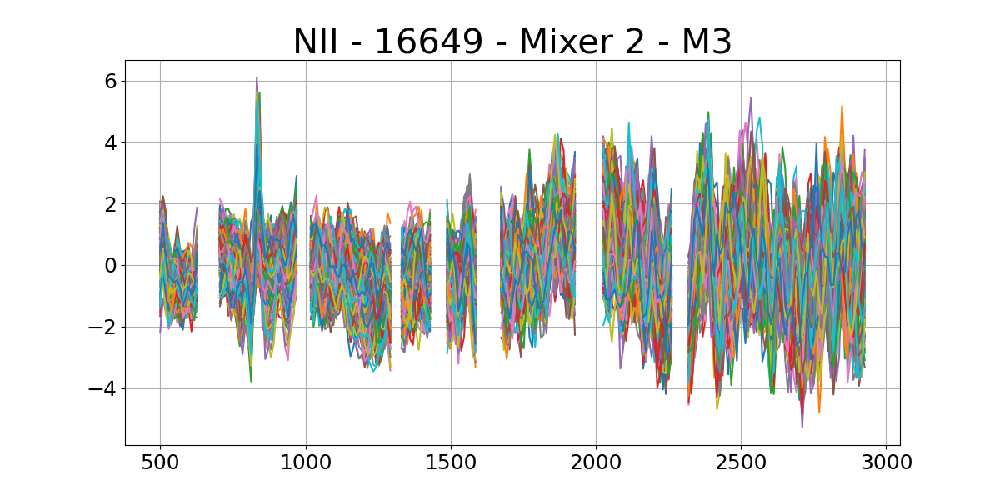

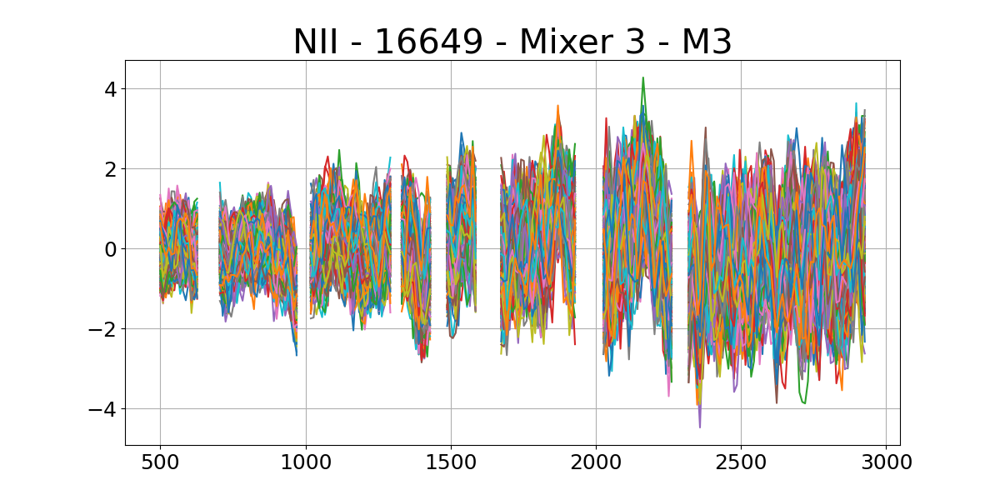

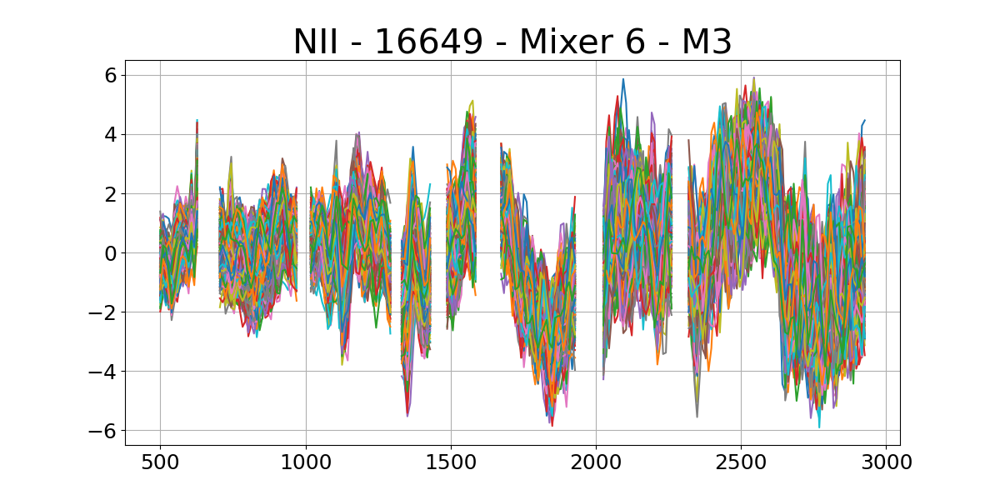

In [3]:
%matplotlib ipympl
import matplotlib.pyplot as plt
plt.rc("font", size=18)

iffreq = np.linspace(1,5000, n_pix)
print(iffreq.min(), iffreq.max(), 5000./(n_pix-1))

aTam = ma.MaskedArray(aTa, mask=data['CHANNEL_FLAG'], )

stype = 'OTF'
add = ''
ringvar = var
print(ringvar)
print(n_spec, n_OTF)

mxs = np.unique(data['MIXER'])
scanID = np.unique(data['scanID'][data['scan_type']=='OTF'])

if line=='CII':
    mn = 1
elif line=='NII':
    mn = 0

for mx in mxs[mn:]:
    fig = plt.figure(figsize=(12,6))
    plt.title("%s - %i - Mixer %i - M%i"%(line, scanID, mx, drmethod), size=30)
    sp1 = plt.subplot()
    for ch in range(n_spec):
        if (data['Mixer'][ch]==mx) & (data['scan_type'][ch]=='OTF') & (ringvar[ch] < 7.0):
            if (np.std(aTam[ch,prange[0]:prange[1]]) < 5.0) & (np.std(aTam[ch,prange[0]:prange[1]]) > 0.10):
                pl1 = plt.plot(iffreq, aTam[ch,:])
    plt.grid()
    
    # pdf_file = opath+'/%s_%i_allspectra_m%i_mx%i_%s%s.pdf'%(line, scanID, meth, mx, stype, add)
    # plt.savefig(pdf_file, format='PDF', orientation='portrait', bbox_inches='tight')
    # print(pdf_file)


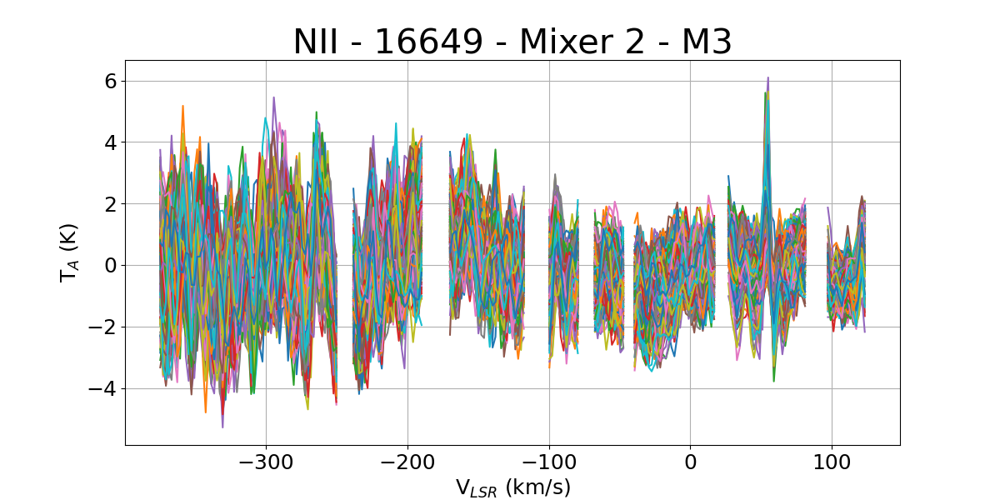

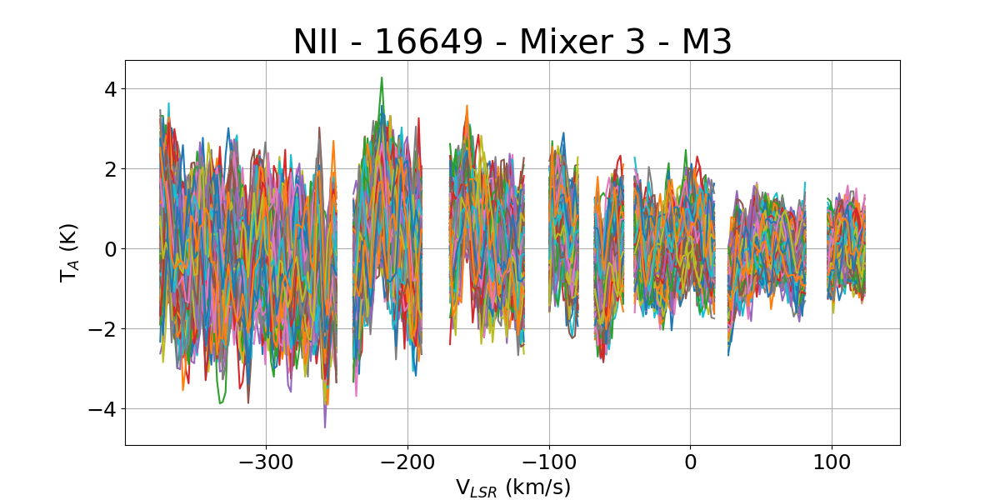

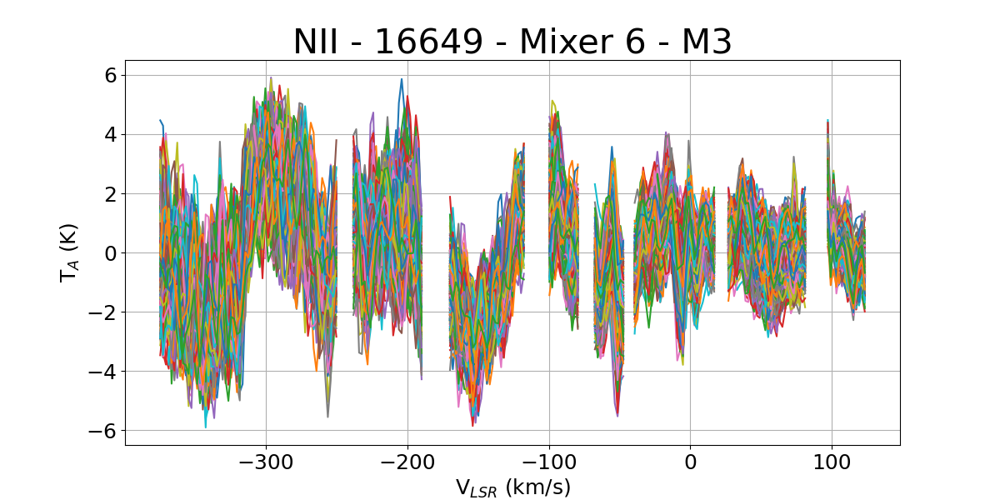

In [4]:
%matplotlib ipympl
import matplotlib.pyplot as plt
plt.rc("font", size=18)

for mx in mxs[mn:]:
    fig = plt.figure(figsize=(12,6))
    plt.title("%s - %i - Mixer %i - M%i"%(line, scanID, mx, drmethod), size=30)
    sp1 = plt.subplot()
    for ch in range(n_spec):
        if (data['Mixer'][ch]==mx) & (data['scan_type'][ch]=='OTF') & (ringvar[ch] < 7.0):
            if (np.std(aTam[ch,prange[0]:prange[1]]) < 5.0) & (np.std(aTam[ch,prange[0]:prange[1]]) > 0.10):
                pl1 = plt.plot(vlsr, aTam[ch,:])
    plt.grid()
    plt.xlabel(r'V$_{LSR}$ (km/s)')
    plt.ylabel(r'T$_A$ (K)')
    
    # pdf_file = opath+'/%s_%i_allspectra_vslr_m%i_mx%i_%s%s.pdf'%(line, scanID, drmethod, mx, stype, add)
    # plt.savefig(pdf_file, format='PDF', orientation='portrait', bbox_inches='tight')
    # print(pdf_file)


1.0 5000.0 9.784735812133073

0.0
prange:  [250, 350]  or in km/s:  -276.20762271991856 -476.9690871187546

<gl>:  352.9366586345785
(1191, 512) 1191
[-476.9690871187546, -276.20762271991856]
[-200, 123.30769143376506]


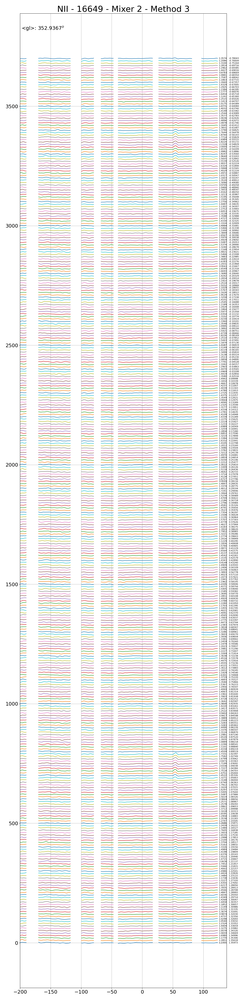

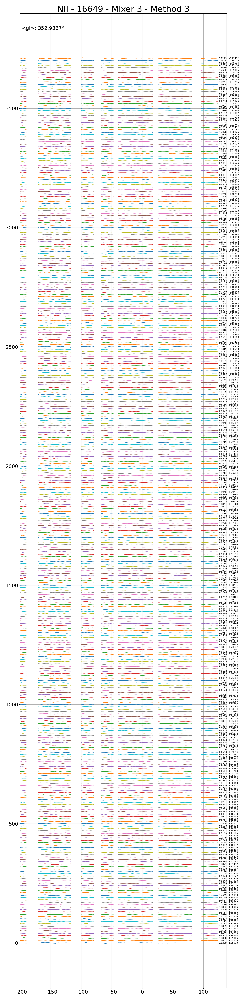

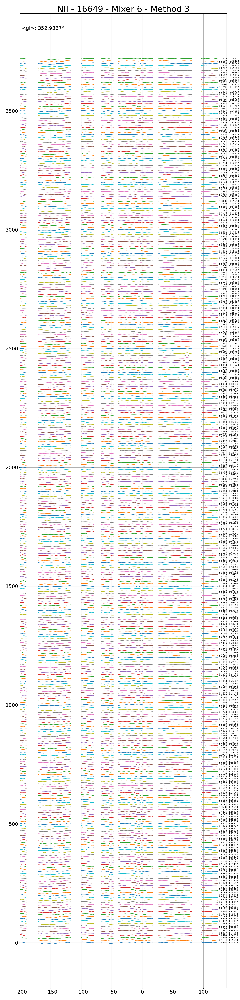

In [5]:
%matplotlib ipympl
import matplotlib.pyplot as plt
from scipy import ndimage

iffreq = np.linspace(1,5000, n_pix)
print(iffreq.min(), iffreq.max(), 5000./(n_pix-1))
print()

if line=='CII':
    prange = [500,700]
elif line=='NII':
    prange = [250,350]
    print((np.ma.std(aTam[ch,prange[0]:prange[1]])))
print('prange: ', prange, ' or in km/s: ', vlsr[prange[0]], vlsr[prange[1]])
print()
print('<gl>: ', np.mean(gl))

mxs = np.unique(data['MIXER'])

mx = mxs[1]
srange = [0, n_spec]
#srange = [300, 440]
#srange = [980, 1080]
#srange = [850, 930]
print(aTa.shape, n_spec)

aTam = ma.MaskedArray(aTa, mask=data['CHANNEL_FLAG'], )

Toff = 10.0

vlim = [np.min([vlsr[prange[0]], vlsr[prange[1]]]), np.max([vlsr[prange[0]], vlsr[prange[1]]])] 
print(vlim)
vlim1 = [vlsr[np.min(np.nonzero(np.isfinite(spec[srange[0]])))], vlsr[np.max(np.nonzero(np.isfinite(spec[srange[0]])))]]
vlim = [np.min(vlim1), np.max(vlim1)]
vlim = [-200, np.max(vlim1)]
print(vlim)

for mx in mxs[mn:]:
    fig = plt.figure(figsize=(12,50))
    plt.title("%s - %i - Mixer %i - Method %i"%(line, scanID, mx, drmethod), size=30)
    sp1 = plt.subplot()
    plt.subplots_adjust(right=0.85)
    cnt = 0
    for ch in range(srange[0], srange[1]):
        if (data['Mixer'][ch]==mx) & (data['scan_type'][ch]=='OTF'):
            # if (np.std(spec[ch,prange[0]:prange[1]]) < 5.0) & (np.std(spec[ch,prange[0]:prange[1]]) > 0.10):
            if (np.ma.std(aTam[ch,prange[0]:prange[1]]) < 5.0) & (np.ma.std(aTam[ch,prange[0]:prange[1]]) > 0.10):
                pl1 = plt.plot(vlsr, aTam[ch,:] + cnt*Toff)

                plt.text(vlim[1]*1.02, cnt*Toff, '%.4f'%(np.ma.std(aTam[ch,prange[0]:prange[1]])), ha='left', va='center', fontsize=8)

                plt.text(vlim[1]*1.15, cnt*Toff, '%.5f'%(gb[ch]), ha='left', va='center', fontsize=8).set_clip_on(False)

                cnt += 1

    plt.tight_layout()
    plt.grid()
    plt.xlim([vlim[0], vlim[1]*1.12])
    ostr = r'<gl>: %.4f$^o$'%(np.mean(gl))
    plt.figtext(0.09, 0.97, ostr)

    # pdf_file = opath+'/%s_%i_specoffset_vlsr_%i-%i_m%i_mx%i_%s%s.pdf'%(line, scanID, srange[0], srange[1], drmethod, mx, stype, add)
    # plt.savefig(pdf_file, format='PDF', orientation='portrait', bbox_inches='tight')
    # print(pdf_file)


1.0 5000.0 9.784735812133073
[-476.9690871187546, -276.20762271991856]
[-374.5807402753482, 123.30769143376506]


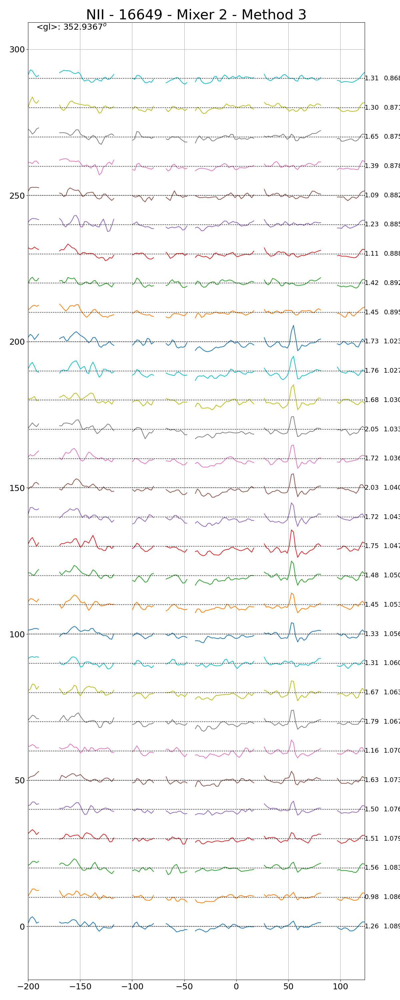

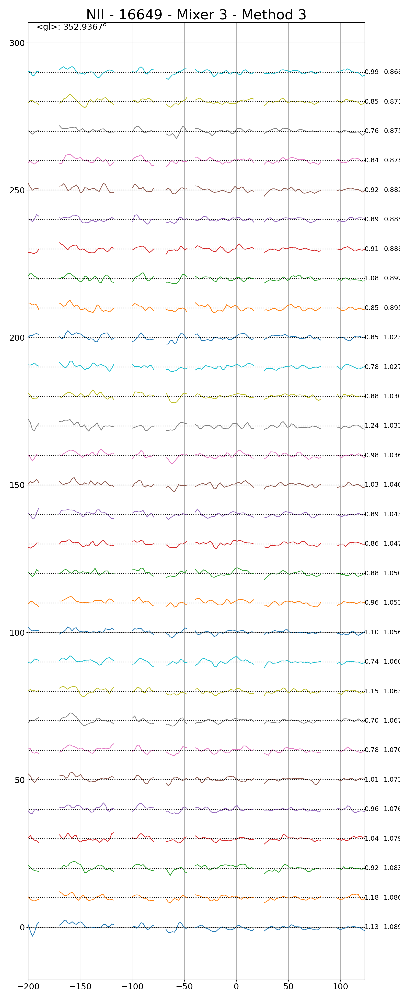

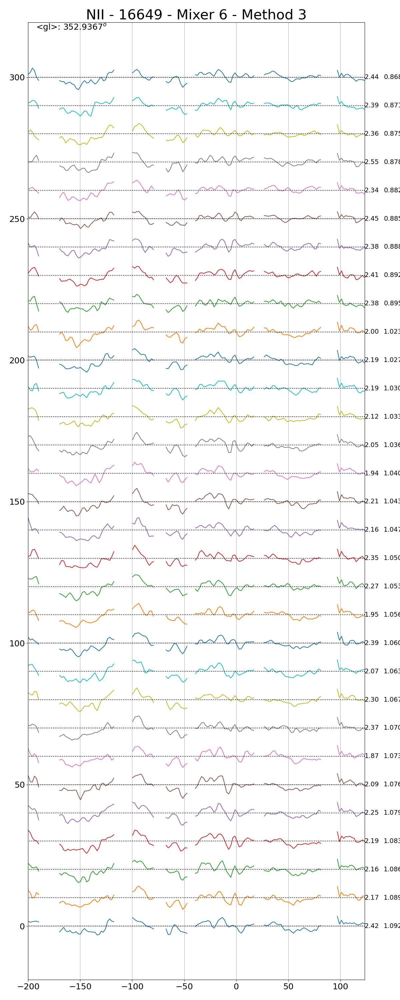

In [6]:
%matplotlib ipympl
import matplotlib.pyplot as plt

iffreq = np.linspace(1,5000, n_pix)
print(iffreq.min(), iffreq.max(), 5000./(n_pix-1))

mxs = np.unique(data['MIXER'])

mx = mxs[1]
srange = [300, 440]
srange = [1020,1150]
srange = [250, 330]
srange = [200, 300]
Toff = 10.0

vlim = [np.min([vlsr[prange[0]], vlsr[prange[1]]]), np.max([vlsr[prange[0]], vlsr[prange[1]]])] 
print(vlim)
vlim1 = [vlsr[np.min(np.nonzero(np.isfinite(spec[srange[0]])))], vlsr[np.max(np.nonzero(np.isfinite(spec[srange[0]])))]]
vlim = [np.min(vlim1), np.max(vlim1)]
print(vlim)

for mx in mxs:
    fig = plt.figure(figsize=(12,30))
    plt.title("%s - %i - Mixer %i - Method %i"%(line, scanID, mx, drmethod), size=30)
    sp1 = plt.subplot()
    plt.subplots_adjust(right=0.2)

    cnt = 0
    for ch in range(srange[0], srange[1]):
        if (data['Mixer'][ch]==mx) & (data['scan_type'][ch]=='OTF'):
            # pl1 = plt.plot(iffreq, spec[ch,:] + cnt*Toff)
            # pl2 = plt.plot([440, 3420], [cnt*Toff,cnt*Toff], linestyle='dotted', color='black')
            # if cnt % 50 == 0:
            #     plt.text(3425, cnt*Toff, '%i-%i'%(cnt, ch), ha='left', va='center', fontsize=14)
            pl1 = plt.plot(vlsr, spec[ch,:] + cnt*Toff)
            pl2 = plt.plot([vlim[0],vlim[1]], [cnt*Toff,cnt*Toff], linestyle='dotted', color='black')
            plt.text(vlim[1], cnt*Toff, '%.2f'%(np.std(spec[ch,prange[0]:prange[1]])), ha='left', va='center', fontsize=14)#.set_clip_on(False)
            plt.text(vlim[1]*1.15, cnt*Toff, '%.5f'%(gb[ch]), ha='left', va='center', fontsize=14)#.set_clip_on(False)
            if cnt % 50 == 0:
                plt.text(vlim[0], cnt*Toff, '%i\n%i'%(cnt, ch), ha='right', va='center', fontsize=14)
            cnt += 1

    plt.tight_layout()
    plt.grid()
    plt.xlim([-200, np.max(vlim1)])
    ostr = r'<gl>: %.4f$^o$'%(np.mean(gl))
    plt.figtext(0.09, 0.97, ostr)

    # pdf_file = opath+'/%s_%i_specoffset_vlsr_%i-%i_m%i_mx%i_%s%s.pdf'%(line, scanID, srange[0], srange[1], meth, mx, stype, add)
    # plt.savefig(pdf_file, format='PDF', orientation='portrait', bbox_inches='tight')
    # print(pdf_file)


In [14]:
from astropy.time import Time
from astropy.table import QTable, Table, Column


__date__ = '9/19/2024'
__updated__ = '20250505'
__version__ = '0.3.2'
__author__ = 'V. Tolls, CfA | Harvard & Smithsonian'

savedata = False

tred = Time(datetime.datetime.now()).fits

# updating header keywords
hdr.set('DLEVEL', value = 0.9, after='PROCTIME')
hdr['PROCTIME'] = tred

#    hdr.insert('VLSR', ('PROC_LEV', 0.9, 'pipeline processing level'), after=True)
#    hdr.add_comment('Level 0.9 Pipeline Processing', before='PROC_LEV')
#hdr.add_comment('Level 0.9 Pipeline Processing', after='VLSR')
hdr.set('L09PTIME', value=tred, comment=('L0.9 pipeline processing time'))
hdr.set('goodpxst', value=pxrange[0], comment='pixel index where good pixels start')
hdr.set('goodpxen', value=pxrange[1], comment='pixel index where good pixel stop')
hdr.set('ringpxst', value=pvrange[0], comment='start pixel index for ringing test')
hdr.set('ringpxen', value=pvrange[1], comment='end pixel index for ringing test')
hdr.set('rwflfilt', value=rowflagfilter, comment='applied rowflag filter for useful spectra')
hdr.set('RFSFLAG', value=rfsflag, comment='flag indicating which REFS are available')
hdr.set('rhID1', value=rhIDs[0], comment='scan ID for REFHOT/REF before OTF')
hdr.set('rhID2', value=rhIDs[1], comment='scan ID for REFHOT/REF after OTF')
for l in range(n_umix):
    hdr.set('Tsysavg%i'%(l), value=aTsys_mean[l], comment='mean Tsys for mixer %i over goodpx'%(l))
    hdr.set('Mixer%i'%(l), value=amixer[l], comment='mixer for Tsys_mean%i'%(l))
hdr.set('procmeth', value=drmethod, comment='data reduction processing method applied')
hdr.set('', value='')
hdr.set('', value='', after='VLSR')
hdr.set('', value='          Level 0.9 Pipeline Processing', after='VLSR')
hdr.set('', value='', after='VLSR')
hdr.add_comment('L0.9 processing time: %s'%(tred))
hdr.add_comment('L0.9 version: %s'%(__version__))
hdr.add_comment('L0.9 last pipeline update: %s'%(__updated__))
hdr.add_comment('L0.9 developer: %s'%(__author__))
hdr.set('', value='', after='procmeth')

os.makedirs(outDir, exist_ok=True)
if debug:
    ofile = os.path.join(outDir+'_m%i'%(drmethod), os.path.split(dfile)[1].replace('.fits','%s_L09.fits'%(fadd)))
    os.makedirs(outDir+'_m%i'%(drmethod), exist_ok=True)
else:
    ofile = os.path.join(outDir, os.path.split(dfile)[1].replace('.fits','_L09.fits'))
    
if savedata:
    fits.writeto(ofile, data=None, header=hdr, overwrite=True)
    fits.append(ofile, data=data, header=hdr1)

# if in debug mode, add more extensions
if debug & validdata:
    # data needed
    # Tsys1, Tsys2, fraca, fracb, Tsyseff, hcorr, spref
    # we have spectra/data for each otf spectrum: Tsyseff, hcorr, spref, fraca, fracb
    # single spectra: Tsys1, Tsys2, 
    # small groupf of spectra: hots
    col1 = Column(aTsyseff, name='Tsyseff', description='effective Tsys per OTF spectrum')
    col2 = Column(ahcorr, name='hcorr', description='effective hot spectrum')
    col3 = Column(aspref, name='spref', description='effective hot for ref spectrum')
    col4 = Column(aspref2, name='spref2', description='ref spectrum')
    col5 = Column(ascorr, name='scorr', description='effective hot spectrum correction')
    if drmethod==3:
        col10 = Column(ahcorr_sm, name='hcorr_sm', description='effective smoothed hot spectrum')
        col11 = Column(aspref_sm, name='spref_sm', description='effective smoothed hot for ref spectrum')
        col12 = Column(aspref2_sm, name='spref2_sm', description='smoothed ref spectrum')
        col13 = Column(aTsyseff_sm, name='Tsyseff_sm', description='smoothed effective Tsys per OTF spectrum')
    col6 = Column(afrac, name='frac', description='fraction of Tsys1/2')
    col7 = Column(spec_org, name='spec', description='original spectra')
    col8 = Column(aTa2, name='tant', description='spectrum without hot correction')
    col9 = Column(var, name='ringvar', description='value for determining if ringing in spectrum')
    col14 = Column(aTam, name='Ta_mean', description='mean of Ta over good pixel range')
    col15 = Column(ahcoef, name='hot coefs', description='coef for hots to create synth. REF')
    
    if drmethod==3:
        fT = Table([col1, col2, col3, col4, col5, col6, col7, col8, col9, col10, col11, col12, col13, col14, col15])
    else:
        fT = Table([col1, col2, col3, col4, col5, col6, col7, col8, col9, col14, col15])
    hdre1 = fits.Header()
    hdre1.set('vcut', value=vcut, comment='ringing treshold used with ringvar')
    fits.append(ofile, data=fT.as_array())
    
    #print('aghots: ', len(aghots))
    if len(aghots) > 0:
        col21 = Column(np.vstack(aghots), name='hots', description='averaged hot spectra')
        col22 = Column(np.hstack(aghtim), name='htime', description='utime of avg. hots')
        col23 = Column(np.hstack(aghmix), name='hmixer', description='mixer of avg. hots')
        col24 = Column(np.hstack(aghtint), name='htint', description='integration time of avg. hots')
        fgh = Table([col21, col22, col23, col24])
        fgh.write(ofile, append=True)
    else:
        fgh = Table()
        fgh.write(ofile, append=True)

    col31 = Column(np.array(atsys), name='Tsys', description='Tsys before/after OTF')
    col32 = Column(np.array(atsmix), name='tsmix', description='mixer of Tsys')
    col33 = Column(np.array(ayfac), name='yfactor', description='y-factor')
    fits.append(ofile, data=Table([col31, col32, col33]).as_array())

    col41 = Column(aTa, name='Ta', description='single mixer antenna temperature')
    fits.append(ofile, data=Table([col41]).as_array())
    
    # this is a crutch to properly name the extensions!
    if savedata:
        with fits.open(ofile) as hdu:
            hdu[2].header['EXTNAME'] = 'DEBUG1'
            hdu[3].header['EXTNAME'] = 'HOTS'
            hdu[4].header['EXTNAME'] = 'Tsys'
            hdu[5].header['EXTNAME'] = 'Ta'
            hdu.writeto(ofile, overwrite=True)

            print('saved file: ', ofile)
    else:
        print('No data saved.')
    


No data saved.


In [3]:
# check conversion to velocity

npix   = hdu[0].header['NPIX']
IF_pix = hdu[0].header['CRPIX1']
IF_val = hdu[0].header['CRVAL1']
IF_del = hdu[0].header['CDELT1']
IF_freq = (np.arange(npix)-IF_pix)*IF_del+IF_val

IF_vlsr0  = hdu[0].header['IF0']
line_freq = hdu[0].header['LINEFREQ']
vlsr = (IF_vlsr0 - IF_freq)/line_freq*const.c.value/1.e3 # Vlsr in km/s

# now, turn the vlsr into a frequency axis
freq = line_freq * (1 - vlsr/const.c.value)